In [2]:
import scanpy as sc
import squidpy as sq

import numpy as np
import pandas as pd

adata1 = sc.read_h5ad('datasets/merfish/H18.06.006.MTG.4000.expand.rep1.h5ad')
adata2 = sc.read_h5ad('datasets/merfish/H18.06.006.MTG.4000.expand.rep2.h5ad')
adata3 = sc.read_h5ad('datasets/merfish/H18.06.006.MTG.4000.expand.rep3.h5ad')
adata1.obs['batch'] = 'H18.06.006.MTG.4000.rep1'
adata2.obs['batch'] = 'H18.06.006.MTG.4000.rep2'
adata3.obs['batch'] = 'H18.06.006.MTG.4000.rep3'

adata1.obs['coord'] = adata1.obsm['spatial'][:,1]
adata1.obs['niche'] = 'N1'
adata1.obs['niche'][adata1.obs['coord']> -1500] = 'N2'
adata1.obs['niche'][adata1.obs['coord']> -1000] = 'N3'
adata1.obs['niche'][adata1.obs['coord']> -200] = 'N4'
adata1.obs['niche'][adata1.obs['coord']> 350] = 'N5'

adata2.obs['coord'] = np.sqrt((adata2.obsm['spatial'][:,0]+3000) ** 2 + (adata2.obsm['spatial'][:,1]-400) ** 2)
adata2.obs['niche'] = 'N6'
adata2.obs['niche'][adata2.obs['coord']> 2100] = 'N5'
adata2.obs['niche'][adata2.obs['coord']> 3600] = 'N4'

adata3.obs['coord'] = np.sqrt((adata3.obsm['spatial'][:,0]-3000) ** 2 + (adata3.obsm['spatial'][:,1]-1300) ** 2)
adata3.obs['niche'] = 'N6'
adata3.obs['niche'][adata3.obs['coord']> 2000] = 'N5'
adata3.obs['niche'][adata3.obs['coord']> 3900] = 'N4'
adata3.obs['niche'][adata3.obs['coord']> 4350] = 'N3'
adata3.obs['niche'][adata3.obs['coord']> 5600] = 'N2'
adata3.obs['niche'][adata3.obs['coord']> 6000] = 'N1'

adata_mtg = sc.concat([adata1,adata2,adata3])
adata_mtg.obs_names_make_unique()
adata_mtg


/tmp/ipykernel_668296/219001496.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata1.obs['niche'][adata1.obs['coord']> -1500] = 'N2'
/tmp/ipykernel_668296/219001496.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata1.obs['niche'][adata1.obs['coord']> -1000] = 'N3'
/tmp/ipykernel_668296/219001496.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata1.obs['niche'][adata1.obs['coord']> -200] = 'N4'
/tmp/ipykernel_66829

AnnData object with n_obs × n_vars = 11059 × 4000
    obs: 'name', 'global.x', 'global.y', 'adjusted.x', 'adjusted.y', 'fov.x', 'fov.y', 'cluster_L1', 'cluster_L2', 'cluster_L3', 'batch', 'coord', 'niche'
    obsm: 'spatial'

In [16]:
from simvi.model import SimVI
SimVI.setup_anndata(adata_mtg,batch_key='batch')
edge_index = SimVI.extract_edge_index(adata_mtg,n_neighbors=10,batch_key='batch')
from pytorch_lightning.utilities.seed import seed_everything
seed_everything(0)
model = SimVI(adata_mtg,kl_weight=1,kl_gatweight=0.01,lam_mi=1000,permutation_rate=0.5,n_spatial=20,n_intrinsic=20)
train_loss, val_loss = model.train(edge_index,max_epochs=100,batch_size=500,use_gpu=True,mae_epochs=25,device='cuda:2')
adata_mtg.obsm['simvi_z'] = model.get_latent_representation(edge_index,representation_kind='intrinsic',give_mean=True)
adata_mtg.obsm['simvi_s'] = model.get_latent_representation(edge_index,representation_kind='interaction',give_mean=True)

se_list, r2_zlist, r2_slist, r2_zpvlist, r2_spvlist, S = model.get_se(edge_index,adata=adata_mtg,num_arch =7, Kfold=1,cell_type_label='cluster_L2')
#se = se_list[0] + se_list[1] + se_list[2] + se_list[3] + se_list[4] + se_list[6] + se_list[7]
se = np.sum(se_list,axis=0)
adata_mtg.var['r2_z'] = np.max(r2_zlist,axis=0)
adata_mtg.var['r2_s'] = np.max(r2_slist,axis=0)


In [4]:
adata_mtg_se = sc.read_h5ad('Bio_results/MTG/mtg_se.h5ad')
adata_mtg_se

AnnData object with n_obs × n_vars = 11059 × 4000
    obs: 'name', 'global.x', 'global.y', 'adjusted.x', 'adjusted.y', 'fov.x', 'fov.y', 'cluster_L1', 'cluster_L2', 'cluster_L3', 'batch', 'coord', 'niche', '_scvi_batch', '_scvi_labels'
    uns: '_scvi_manager_uuid', '_scvi_uuid', 'batch_colors', 'cluster_L1_colors', 'cluster_L2_colors', 'neighbors', 'niche_colors', 'pca', 'umap'
    obsm: 'X_pca', 'X_umap', 'simvi_lz', 'simvi_s', 'simvi_z', 'spatial'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

/tmp/ipykernel_3067688/1603110543.py:4: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


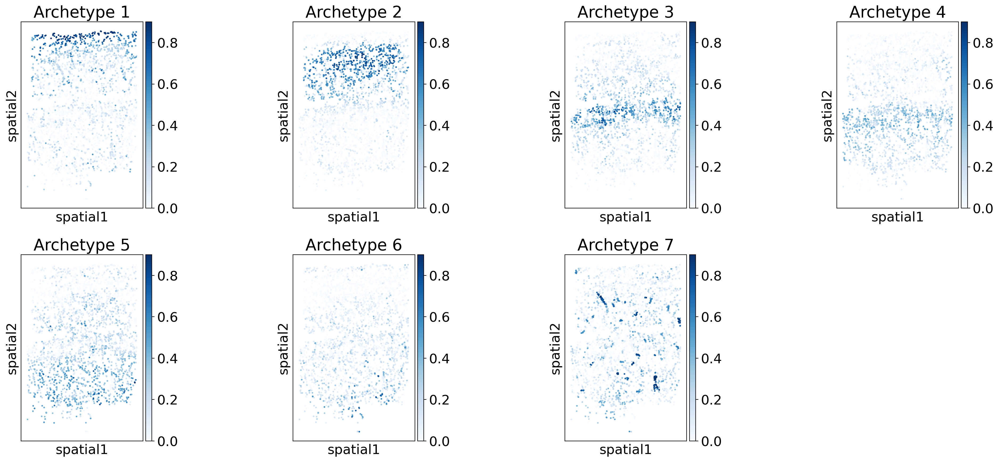

In [652]:
adata_mtg.obsm['S'] = pd.DataFrame(S[:,[1,0,2,4,6,3,5]],columns = ['Interactype ' + str(i+1) for i in range(S.shape[1])],index=adata_mtg.obs_names)
ll = ['Interactype ' + str(i+1) for i in range(S.shape[1])]
tt = ['Archetype ' + str(i+1) for i in range(S.shape[1])]
sc.pl.spatial(sq.pl.extract(adata_mtg[adata_mtg_se.obs['batch']==adata_mtg_se.obs['batch'].unique()[0]],'S'),color=ll,vmax=0.9,spot_size=40,cmap='Blues',wspace=0,title=tt,show=False)
plt.tight_layout()

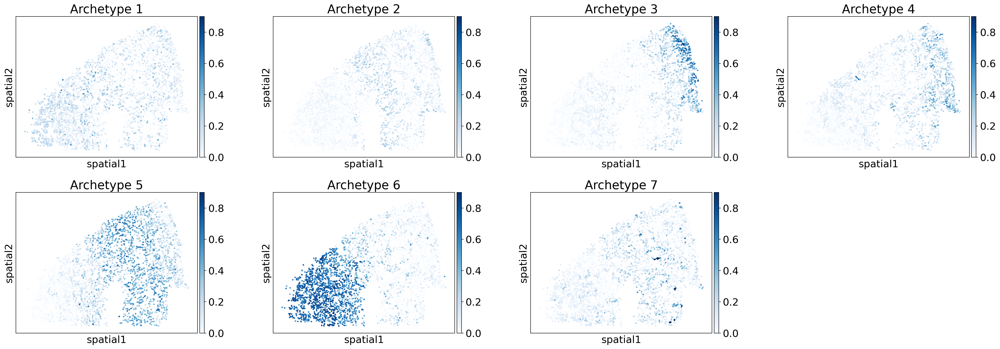

In [653]:
sc.pl.spatial(sq.pl.extract(adata_mtg[adata_mtg_se.obs['batch']==adata_mtg_se.obs['batch'].unique()[1]],'S'),color=ll,title=tt,spot_size=40,vmax=0.9,wspace=0.2,cmap='Blues',save='interactype_mtgrep2_new.pdf')

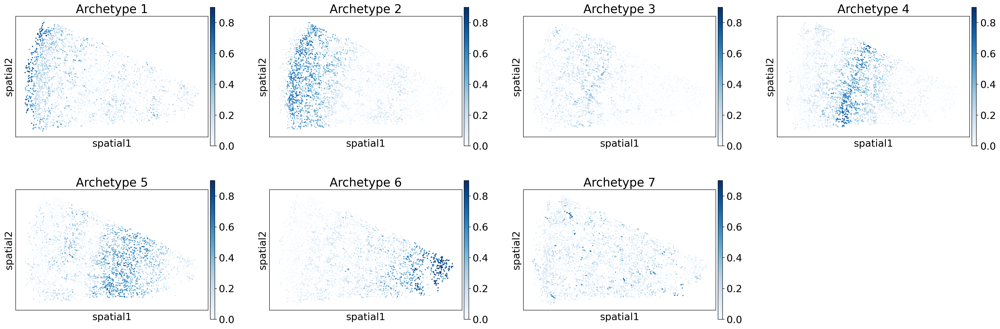

In [654]:
sc.pl.spatial(sq.pl.extract(adata_mtg[adata_mtg_se.obs['batch']==adata_mtg_se.obs['batch'].unique()[2]],'S'),color=ll,title=tt,spot_size=40,vmax=0.9,wspace=0.2,cmap='Blues',save='interactype_mtgrep3_new.pdf')

In [8]:
adata_mtg_ = adata_mtg.copy()
sc.pp.normalize_total(adata_mtg_)
sc.pp.log1p(adata_mtg_)
sc.pp.highly_variable_genes(adata_mtg_,n_top_genes=1000)
adata_mtg_ = adata_mtg_[:,adata_mtg_.var['means']>0.1]
adata_mtg_

View of AnnData object with n_obs × n_vars = 11059 × 1561
    obs: 'name', 'global.x', 'global.y', 'adjusted.x', 'adjusted.y', 'fov.x', 'fov.y', 'cluster_L1', 'cluster_L2', 'cluster_L3', 'batch', 'coord', 'niche', '_scvi_batch', '_scvi_labels'
    var: 'r2_z', 'r2_s', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: '_scvi_uuid', '_scvi_manager_uuid', 'log1p', 'hvg'
    obsm: 'spatial', 'simvi_s', 'simvi_z'

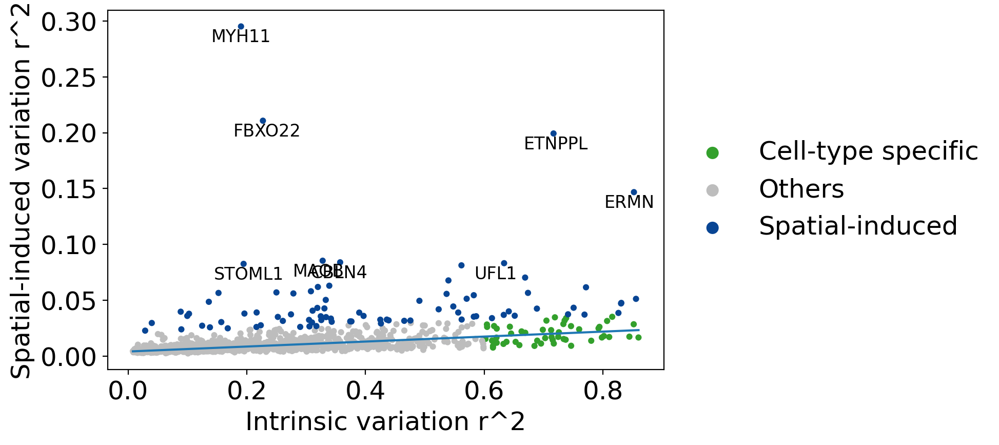

In [67]:
from sklearn.linear_model import HuberRegressor

hr = HuberRegressor()
hr.fit(adata_mtg_.var['r2_z'].values.reshape(-1,1),adata_mtg_.var['r2_s'].values)


adata_mtg_.var['class'] = 'Others'

adata_mtg_.var['class'][adata_mtg_.var['r2_z']>0.6] = 'Cell-type specific'
adata_mtg_.var['class'][np.abs(adata_mtg_.var['r2_s'].values - hr.predict(adata_mtg_.var['r2_z'].values.reshape(-1,1)) ) / hr.scale_ > 10] = 'Spatial-induced'

import matplotlib.pyplot as plt
plt.rcParams['figure.dpi'] = 200
plt.rcParams["font.size"] = 18

adata_mtg_.uns['class_colors'] = ['#33a02c','#bdbdbd','#084594']



sc.pl.scatter(adata_mtg_.copy(),x='r2_z',y='r2_s',show=False,color='class')
plt.plot(adata_mtg_.var['r2_z'].values[np.argsort(adata_mtg_.var['r2_z'].values)],hr.predict(adata_mtg_.var['r2_z'].values.reshape(-1,1))[np.argsort(adata_mtg_.var['r2_z'].values)])

for i in range(adata_mtg_.var['r2_s'].shape[0]):
    if adata_mtg_.var['r2_s'][i] > 0.082:
        plt.text(adata_mtg_.var['r2_z'][i]-0.05,adata_mtg_.var['r2_s'][i]-0.014,adata_mtg_.var_names[i],fontsize=12)
        
plt.xlabel('Intrinsic variation r^2')
plt.ylabel('Spatial-induced variation r^2')
plt.title('')

plt.savefig('figures/r2scatter_mtg.pdf')

In [4]:
adata_mtg_se = adata_mtg.copy()
adata_mtg_se.X = se
adata_mtg_se.X

array([[ 0.0357818 , -0.0141311 , -0.00202113, ...,  0.01637765,
        -0.00984399,  0.        ],
       [ 0.04935045, -0.01805999, -0.00780678, ...,  0.0045418 ,
         0.00602388,  0.        ],
       [ 0.14354528,  0.04240004, -0.00968427, ..., -0.04723293,
        -0.00326154,  0.        ],
       ...,
       [-0.05053382,  0.04525666, -0.00058104, ..., -0.0090016 ,
        -0.0187835 ,  0.        ],
       [ 0.06262365, -0.01109252, -0.01896996, ...,  0.06797742,
        -0.03141629,  0.        ],
       [ 0.08474464, -0.0533442 , -0.00486352, ...,  0.06262204,
         0.03685724,  0.        ]])

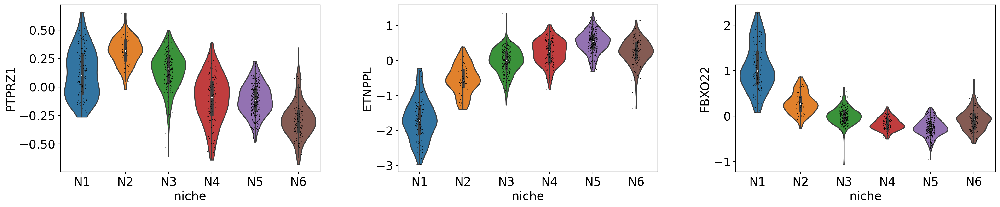

In [98]:
sc.pl.violin(adata_mtg_se[adata_mtg.obs['cluster_L1']=='lASC'],['PTPRZ1','ETNPPL','FBXO22'],'niche',inner='box')

/usr/local/lib/python3.8/dist-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


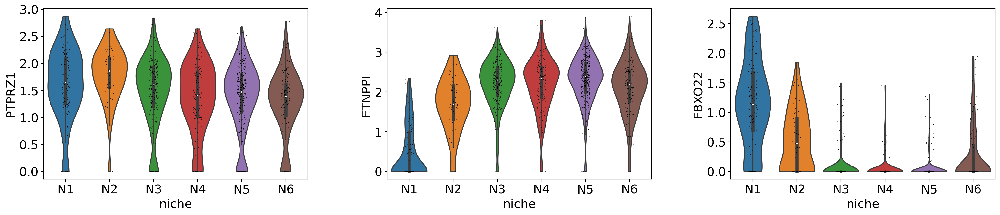

In [99]:
sc.pl.violin(adata_mtg_[adata_mtg.obs['cluster_L1']=='lASC'],['PTPRZ1','ETNPPL','FBXO22'],'niche',inner='box')

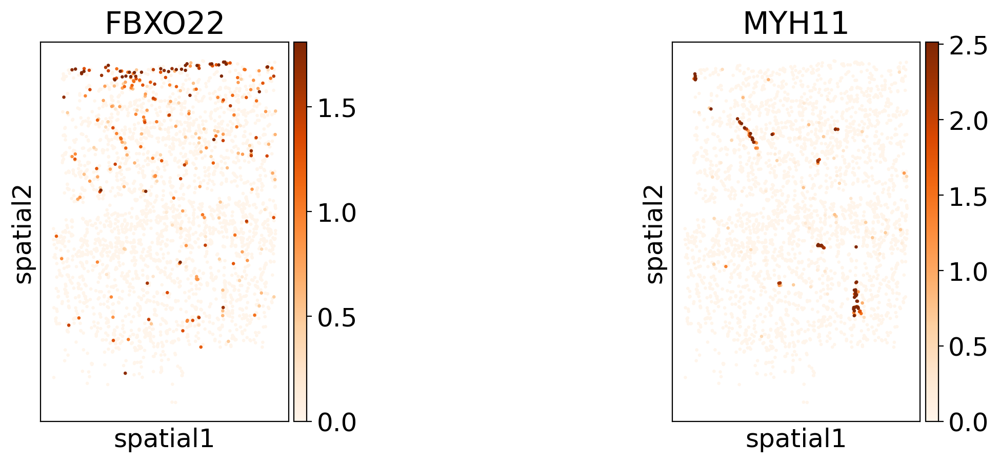

In [94]:
#adata_mtg_ = adata_mtg.copy()
#sc.pp.normalize_total(adata_mtg_)
#sc.pp.log1p(adata_mtg_)
sc.pl.spatial(adata_mtg_[adata_mtg_.obs['batch']==adata_mtg_.obs['batch'].unique()[0]],color=['FBXO22','MYH11'],vmax='p99',vmin=0,spot_size=40,cmap='Oranges',save='mtg_ngenes.pdf')

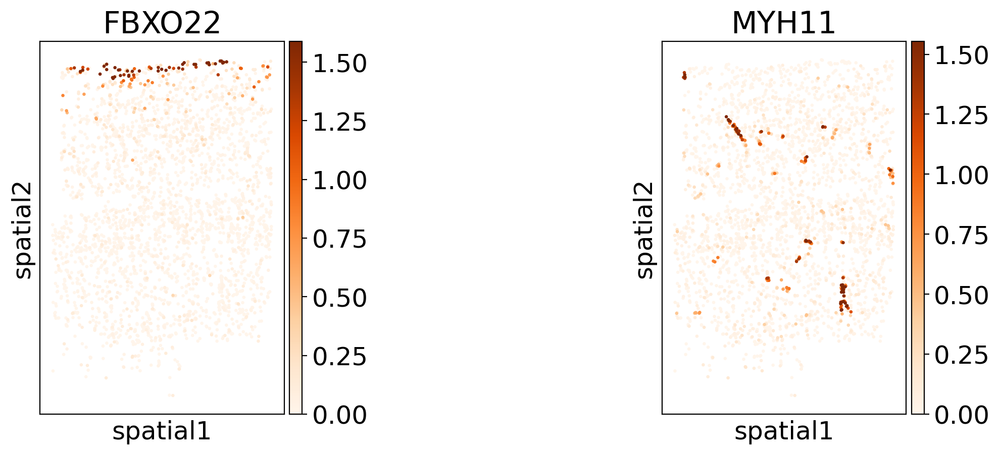

In [93]:
sc.pl.spatial(adata_mtg_se[adata_mtg_se.obs['batch']==adata_mtg_se.obs['batch'].unique()[0]],color=['FBXO22','MYH11'],vmax='p99',vmin=0,spot_size=40,cmap='Oranges',save='mtg_segenes.pdf')

In [264]:
#adata_mtg_se_ = adata_mtg_se[:,adata_mtg_.var_names].copy()
adata_mtg_se_1 = adata_mtg_se_[adata_mtg_se.obs['batch']==adata_mtg_se.obs['batch'].unique()[0]].copy()
adata_mtg_se_1 = adata_mtg_se_1[adata_mtg_se_1.obs['cluster_L1']=='lASC']
df = pd.DataFrame(adata_mtg_se_1.X,columns = adata_mtg_se_1.var_names)
df['x'] = adata_mtg_se_1.obsm['spatial'][:,1]

bins = np.linspace(df['x'].min(), df['x'].max(), 26)

df['bin'] = pd.cut(df['x'], bins=bins, include_lowest=True, labels=range(25))

bin_means = df.groupby('bin').mean().dropna()
bin_means = bin_means.iloc[:,:-1]
adata_mtg_se_1.obs['bin'] = df['bin'].values.copy()
#sc.pp.scale(adata_mtg_se_1)

In [272]:
from sklearn.cluster import KMeans
kmeans = KMeans(n_clusters=8, random_state=0).fit(bin_means.T)
pd.DataFrame(kmeans.labels_)

/usr/local/lib/python3.8/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


array([4, 4, 1, ..., 7, 4, 4], dtype=int32)

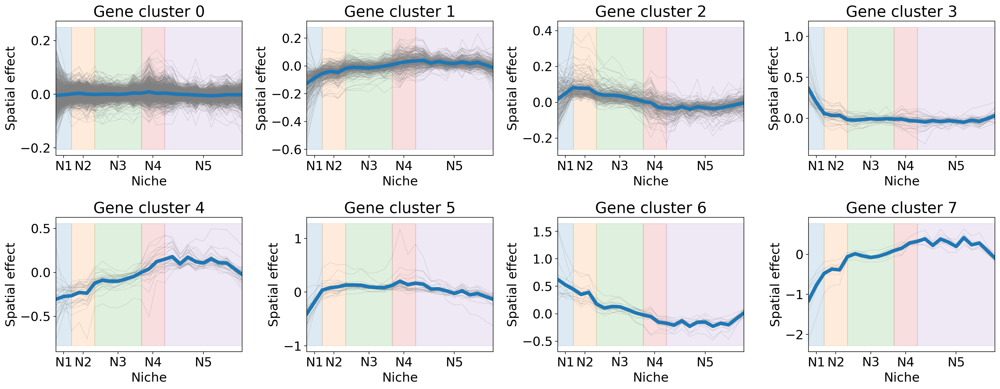

In [303]:
fig, axes = plt.subplots(2,4,figsize=(20,8))
c_list = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd']
j = 0
k = 0
for i in range(8):
    ind = pd.DataFrame(kmeans.labels_).value_counts().index.values[i][0]
    axes[j,k].plot(bin_means.index.astype(int),bin_means.loc[:,kmeans.labels_==ind].values,color='gray',linewidth=0.5,alpha=0.35)
    axes[j,k].plot(bin_means.index.astype(int),np.mean(bin_means.loc[:,kmeans.labels_==ind].values,axis=1),linewidth=5)
    axes[j,k].set_xlabel('Niche')
    
    custom_ticks = [1, 3.5,8,12.5,19]
    custom_labels = ['N1','N2','N3','N4','N5']
    axes[j,k].set_xticks(custom_ticks, custom_labels)
    axes[j,k].set_ylabel('Spatial effect')
    axes[j,k].set_xlim((0,24))
    axes[j,k].set_title('Gene cluster '+str(i))
    x = bin_means.index.astype(int)
    y = axes[j,k].get_ylim()
    axes[j,k].fill_between(bin_means.index.astype(int), y[1],y[0], where=(x <= 2), color=c_list[0], alpha=0.15)
    axes[j,k].fill_between(bin_means.index.astype(int), y[1],y[0], where=(x >= 2) & (x <= 5), color=c_list[1], alpha=0.15)
    axes[j,k].fill_between(bin_means.index.astype(int), y[1],y[0], where=(x >= 5) & (x <= 11), color=c_list[2], alpha=0.15)
    axes[j,k].fill_between(bin_means.index.astype(int), y[1],y[0], where=(x >= 11) & (x <= 14), color=c_list[3], alpha=0.15)
    axes[j,k].fill_between(bin_means.index.astype(int), y[1],y[0], where=(x >= 14) & (x <= 24), color=c_list[4], alpha=0.15)
    k = k + 1
    if k > 3:
        k = 0
        j = 1
        
        
plt.tight_layout()
plt.savefig('figures/mtg_ASC_se.pdf',bbox_inches='tight')

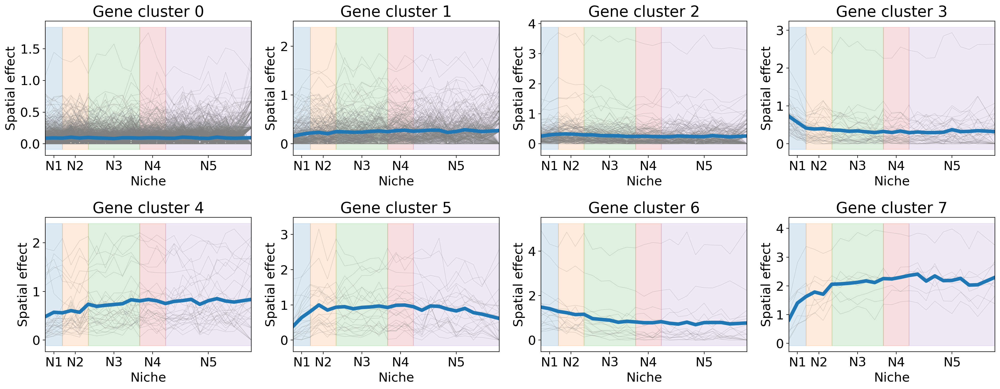

In [304]:
adata_mtg_1 = adata_mtg_[adata_mtg_.obs['batch']==adata_mtg_se.obs['batch'].unique()[0]].copy()
adata_mtg_1 = adata_mtg_1[adata_mtg_1.obs['cluster_L1']=='lASC']
df = pd.DataFrame(adata_mtg_1.X,columns = adata_mtg_se_1.var_names)
df['x'] = adata_mtg_1.obsm['spatial'][:,1]

bins = np.linspace(df['x'].min(), df['x'].max(), 26)


df['bin'] = pd.cut(df['x'], bins=bins, include_lowest=True, labels=range(25))


bin_means = df.groupby('bin').mean().dropna()
bin_means = bin_means.iloc[:,:-1]

fig, axes = plt.subplots(2,4,figsize=(20,8))
c_list = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd']
j = 0
k = 0
for i in range(8):
    ind = pd.DataFrame(kmeans.labels_).value_counts().index.values[i][0]
    axes[j,k].plot(bin_means.index.astype(int),bin_means.loc[:,kmeans.labels_==ind].values,color='gray',linewidth=0.5,alpha=0.35)
    axes[j,k].plot(bin_means.index.astype(int),np.mean(bin_means.loc[:,kmeans.labels_==ind].values,axis=1),linewidth=5)
    axes[j,k].set_xlabel('Niche')
    
    custom_ticks = [1, 3.5,8,12.5,19]
    custom_labels = ['N1','N2','N3','N4','N5']
    axes[j,k].set_xticks(custom_ticks, custom_labels)
    axes[j,k].set_ylabel('Spatial effect')
    axes[j,k].set_xlim((0,24))
    axes[j,k].set_title('Gene cluster '+str(i))
    x = bin_means.index.astype(int)
    y = axes[j,k].get_ylim()
    axes[j,k].fill_between(bin_means.index.astype(int), y[1],y[0], where=(x <= 2), color=c_list[0], alpha=0.15)
    axes[j,k].fill_between(bin_means.index.astype(int), y[1],y[0], where=(x >= 2) & (x <= 5), color=c_list[1], alpha=0.15)
    axes[j,k].fill_between(bin_means.index.astype(int), y[1],y[0], where=(x >= 5) & (x <= 11), color=c_list[2], alpha=0.15)
    axes[j,k].fill_between(bin_means.index.astype(int), y[1],y[0], where=(x >= 11) & (x <= 14), color=c_list[3], alpha=0.15)
    axes[j,k].fill_between(bin_means.index.astype(int), y[1],y[0], where=(x >= 14) & (x <= 24), color=c_list[4], alpha=0.15)
    k = k + 1
    if k > 3:
        k = 0
        j = 1
        
        
plt.tight_layout()
plt.savefig('figures/mtg_ASC_normalizedcounts.pdf',bbox_inches='tight')

/usr/local/lib/python3.8/dist-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


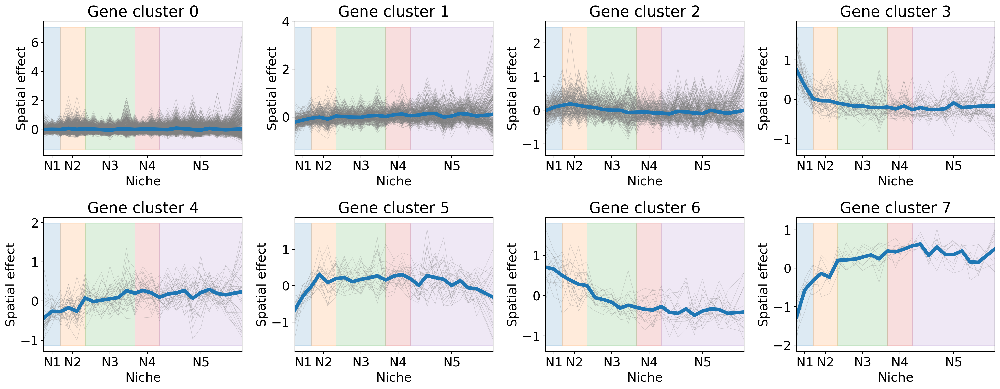

In [305]:
adata_mtg_1 = adata_mtg_[adata_mtg_.obs['batch']==adata_mtg_se.obs['batch'].unique()[0]].copy()
adata_mtg_1 = adata_mtg_1[adata_mtg_1.obs['cluster_L1']=='lASC']
sc.pp.scale(adata_mtg_1)
df = pd.DataFrame(adata_mtg_1.X,columns = adata_mtg_se_1.var_names)
df['x'] = adata_mtg_1.obsm['spatial'][:,1]

bins = np.linspace(df['x'].min(), df['x'].max(), 26)


df['bin'] = pd.cut(df['x'], bins=bins, include_lowest=True, labels=range(25))


bin_means = df.groupby('bin').mean().dropna()
bin_means = bin_means.iloc[:,:-1]

fig, axes = plt.subplots(2,4,figsize=(20,8))
c_list = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd']
j = 0
k = 0
for i in range(8):
    ind = pd.DataFrame(kmeans.labels_).value_counts().index.values[i][0]
    axes[j,k].plot(bin_means.index.astype(int),bin_means.loc[:,kmeans.labels_==ind].values,color='gray',linewidth=0.5,alpha=0.35)
    axes[j,k].plot(bin_means.index.astype(int),np.mean(bin_means.loc[:,kmeans.labels_==ind].values,axis=1),linewidth=5)
    axes[j,k].set_xlabel('Niche')
    
    custom_ticks = [1, 3.5,8,12.5,19]
    custom_labels = ['N1','N2','N3','N4','N5']
    axes[j,k].set_xticks(custom_ticks, custom_labels)
    axes[j,k].set_ylabel('Spatial effect')
    axes[j,k].set_xlim((0,24))
    axes[j,k].set_title('Gene cluster '+str(i))
    x = bin_means.index.astype(int)
    y = axes[j,k].get_ylim()
    axes[j,k].fill_between(bin_means.index.astype(int), y[1],y[0], where=(x <= 2), color=c_list[0], alpha=0.15)
    axes[j,k].fill_between(bin_means.index.astype(int), y[1],y[0], where=(x >= 2) & (x <= 5), color=c_list[1], alpha=0.15)
    axes[j,k].fill_between(bin_means.index.astype(int), y[1],y[0], where=(x >= 5) & (x <= 11), color=c_list[2], alpha=0.15)
    axes[j,k].fill_between(bin_means.index.astype(int), y[1],y[0], where=(x >= 11) & (x <= 14), color=c_list[3], alpha=0.15)
    axes[j,k].fill_between(bin_means.index.astype(int), y[1],y[0], where=(x >= 14) & (x <= 24), color=c_list[4], alpha=0.15)
    k = k + 1
    if k > 3:
        k = 0
        j = 1
        
        
plt.tight_layout()
plt.savefig('figures/mtg_ASC_scaledcounts.pdf',bbox_inches='tight')

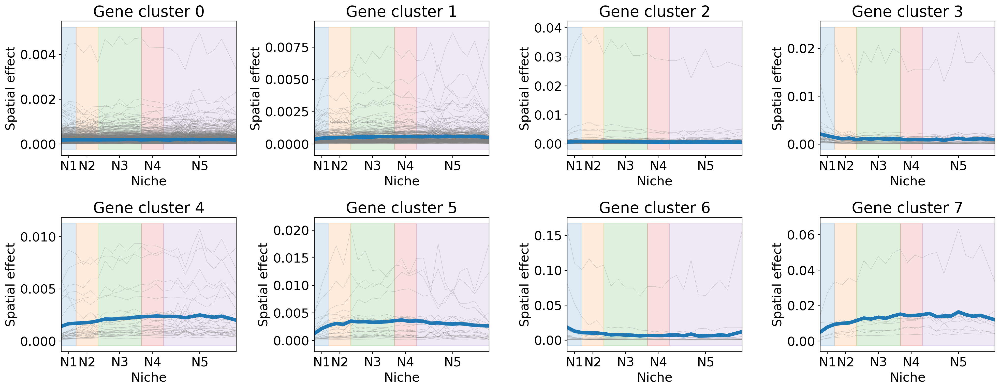

In [327]:
adata_mtg_r1 = adata_mtg.copy()
adata_mtg_r1.X = model.get_decoded_expression(edge_index)
adata_mtg_r1 = adata_mtg_r1[:,adata_mtg_1.var_names]

adata_mtg_r1 = adata_mtg_r1[adata_mtg_r1.obs['batch']==adata_mtg_se.obs['batch'].unique()[0]].copy()
adata_mtg_r1 = adata_mtg_r1[adata_mtg_r1.obs['cluster_L1']=='lASC']
df = pd.DataFrame(adata_mtg_r1.X,columns = adata_mtg_se_1.var_names)
df['x'] = adata_mtg_r1.obsm['spatial'][:,1]

bins = np.linspace(df['x'].min(), df['x'].max(), 26)

df['bin'] = pd.cut(df['x'], bins=bins, include_lowest=True, labels=range(25))

bin_means = df.groupby('bin').mean().dropna()
bin_means = bin_means.iloc[:,:-1]

fig, axes = plt.subplots(2,4,figsize=(20,8))
c_list = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd']
j = 0
k = 0
for i in range(8):
    ind = pd.DataFrame(kmeans.labels_).value_counts().index.values[i][0]
    axes[j,k].plot(bin_means.index.astype(int),bin_means.loc[:,kmeans.labels_==ind].values,color='gray',linewidth=0.5,alpha=0.35)
    axes[j,k].plot(bin_means.index.astype(int),np.mean(bin_means.loc[:,kmeans.labels_==ind].values,axis=1),linewidth=5)
    axes[j,k].set_xlabel('Niche')
    
    custom_ticks = [1, 3.5,8,12.5,19]
    custom_labels = ['N1','N2','N3','N4','N5']
    axes[j,k].set_xticks(custom_ticks, custom_labels)
    axes[j,k].set_ylabel('Spatial effect')
    axes[j,k].set_xlim((0,24))
    axes[j,k].set_title('Gene cluster '+str(i))
    x = bin_means.index.astype(int)
    y = axes[j,k].get_ylim()
    axes[j,k].fill_between(bin_means.index.astype(int), y[1],y[0], where=(x <= 2), color=c_list[0], alpha=0.15)
    axes[j,k].fill_between(bin_means.index.astype(int), y[1],y[0], where=(x >= 2) & (x <= 5), color=c_list[1], alpha=0.15)
    axes[j,k].fill_between(bin_means.index.astype(int), y[1],y[0], where=(x >= 5) & (x <= 11), color=c_list[2], alpha=0.15)
    axes[j,k].fill_between(bin_means.index.astype(int), y[1],y[0], where=(x >= 11) & (x <= 14), color=c_list[3], alpha=0.15)
    axes[j,k].fill_between(bin_means.index.astype(int), y[1],y[0], where=(x >= 14) & (x <= 24), color=c_list[4], alpha=0.15)
    k = k + 1
    if k > 3:
        k = 0
        j = 1
        
        
plt.tight_layout()
plt.savefig('figures/mtg_ASC_scvicounts.pdf',bbox_inches='tight')

In [388]:
from scipy.stats import kendalltau
from scipy.stats import spearmanr

sp = np.zeros(adata_mtg_1.shape[1])
kt = np.zeros(adata_mtg_1.shape[1])
j = 0
for source_row in adata_mtg_1.X.T:
    sp[j], pv = spearmanr(source_row, adata_mtg_1.obsm['spatial'][:,0])
    kt[j], pv = kendalltau(source_row, adata_mtg_1.obsm['spatial'][:,0])
    j = j + 1
kt = np.abs(kt)
sp = np.abs(sp)

/usr/local/lib/python3.8/dist-packages/scipy/stats/_stats_py.py:4916: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(warn_msg))


In [389]:
from scipy.stats import kendalltau

sp_se = np.zeros(adata_mtg_1.shape[1])
kt_se = np.zeros(adata_mtg_1.shape[1])
j = 0
for source_row in adata_mtg_se_1.X.T:
    sp_se[j], pv = spearmanr(source_row, adata_mtg_1.obsm['spatial'][:,0])
    kt_se[j], pv = kendalltau(source_row, adata_mtg_1.obsm['spatial'][:,0])
    j = j + 1
kt_se = np.abs(kt_se)
sp_se = np.abs(sp_se)

In [390]:
from scipy.stats import kendalltau

sp_scvi = np.zeros(adata_mtg_r1.shape[1])
kt_scvi = np.zeros(adata_mtg_r1.shape[1])
j = 0
for source_row in adata_mtg_k1.X.T:
    sp_scvi[j], pv = spearmanr(source_row, adata_mtg_1.obsm['spatial'][:,0])
    kt_scvi[j], pv = kendalltau(source_row, adata_mtg_1.obsm['spatial'][:,0])
    j = j + 1
kt_scvi = np.abs(kt_scvi)
sp_scvi = np.abs(sp_scvi)

In [391]:
from scipy.stats import kendalltau
from scipy.stats import spearmanr
from sklearn.neighbors import kneighbors_graph

adata_mtg_1 = adata_mtg_[adata_mtg_.obs['batch']==adata_mtg_se.obs['batch'].unique()[0]].copy()
adata_mtg_1 = adata_mtg_1[adata_mtg_1.obs['cluster_L1']=='lASC']

adata_mtg_k1 = adata_mtg_1.copy()

A = kneighbors_graph(adata_mtg_k1.obsm['simvi_z'],n_neighbors = 20)
adata_mtg_k1.X = adata_mtg_k1.X - 0.05 * A @ adata_mtg_k1.X 


sp_k = np.zeros(adata_mtg_k1.shape[1])
kt_k = np.zeros(adata_mtg_k1.shape[1])
j = 0
for source_row in adata_mtg_k1.X.T:
    sp_k[j], pv = spearmanr(source_row, adata_mtg_1.obsm['spatial'][:,0])
    kt_k[j], pv = kendalltau(source_row, adata_mtg_1.obsm['spatial'][:,0])
    j = j + 1
kt_k = np.abs(kt_k)
sp_k = np.abs(sp_k)

/usr/local/lib/python3.8/dist-packages/scipy/stats/_stats_py.py:4916: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(warn_msg))


/usr/local/lib/python3.8/dist-packages/scvi/data/_utils.py:156: UserWarning: Category 39 in adata.obs['_scvi_batch'] has fewer than 3 cells. Models may not train properly.
  warnings.warn(
Global seed set to 0
Epoch 100/100: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 100/100 [00:20<00:00,  4.86it/s, train_loss=1.45e+3, val_loss=1450.5415]


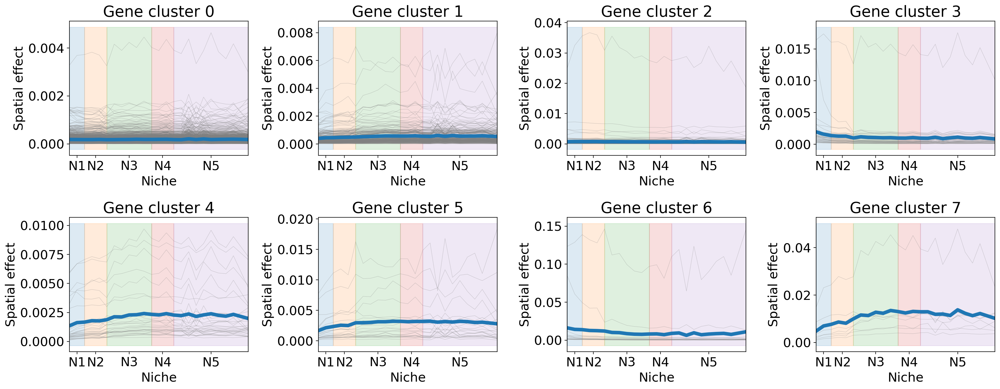

In [400]:
from simvi.model import SimVIGraphOnly
adata_mtg.obs['batchct'] = adata_mtg.obs['batch'].astype(str)+adata_mtg.obs['cluster_L2'].astype(str)
SimVIGraphOnly.setup_anndata(adata_mtg,batch_key='batchct')

from pytorch_lightning.utilities.seed import seed_everything
seed_everything(0)
model_go = SimVIGraphOnly(adata_mtg,kl_weight=1,kl_gatweight=1,lam_mi=1000,permutation_rate=0,n_spatial=20)
train_loss, val_loss = model_go.train(edge_index,max_epochs=100,batch_size=1000,use_gpu=True)

adata_mtg_go1 = adata_mtg.copy()
adata_mtg_go1.X = model_go.get_decoded_expression(edge_index)
adata_mtg_go1 = adata_mtg_go1[:,adata_mtg_1.var_names]

adata_mtg_go1 = adata_mtg_go1[adata_mtg_go1.obs['batch']==adata_mtg_se.obs['batch'].unique()[0]].copy()
adata_mtg_go1 = adata_mtg_go1[adata_mtg_go1.obs['cluster_L1']=='lASC']
df = pd.DataFrame(adata_mtg_go1.X,columns = adata_mtg_se_1.var_names)
df['x'] = adata_mtg_go1.obsm['spatial'][:,1]

bins = np.linspace(df['x'].min(), df['x'].max(), 26)


df['bin'] = pd.cut(df['x'], bins=bins, include_lowest=True, labels=range(25))


bin_means = df.groupby('bin').mean().dropna()
bin_means = bin_means.iloc[:,:-1]

fig, axes = plt.subplots(2,4,figsize=(20,8))
c_list = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd']
j = 0
k = 0
for i in range(8):
    ind = pd.DataFrame(kmeans.labels_).value_counts().index.values[i][0]
    axes[j,k].plot(bin_means.index.astype(int),bin_means.loc[:,kmeans.labels_==ind].values,color='gray',linewidth=0.5,alpha=0.35)
    axes[j,k].plot(bin_means.index.astype(int),np.mean(bin_means.loc[:,kmeans.labels_==ind].values,axis=1),linewidth=5)
    axes[j,k].set_xlabel('Niche')
    
    custom_ticks = [1, 3.5,8,12.5,19]
    custom_labels = ['N1','N2','N3','N4','N5']
    axes[j,k].set_xticks(custom_ticks, custom_labels)
    axes[j,k].set_ylabel('Spatial effect')
    axes[j,k].set_xlim((0,24))
    axes[j,k].set_title('Gene cluster '+str(i))
    x = bin_means.index.astype(int)
    y = axes[j,k].get_ylim()
    axes[j,k].fill_between(bin_means.index.astype(int), y[1],y[0], where=(x <= 2), color=c_list[0], alpha=0.15)
    axes[j,k].fill_between(bin_means.index.astype(int), y[1],y[0], where=(x >= 2) & (x <= 5), color=c_list[1], alpha=0.15)
    axes[j,k].fill_between(bin_means.index.astype(int), y[1],y[0], where=(x >= 5) & (x <= 11), color=c_list[2], alpha=0.15)
    axes[j,k].fill_between(bin_means.index.astype(int), y[1],y[0], where=(x >= 11) & (x <= 14), color=c_list[3], alpha=0.15)
    axes[j,k].fill_between(bin_means.index.astype(int), y[1],y[0], where=(x >= 14) & (x <= 24), color=c_list[4], alpha=0.15)
    k = k + 1
    if k > 3:
        k = 0
        j = 1
        
        
plt.tight_layout()
plt.savefig('figures/mtg_ASC_graphonly.pdf',bbox_inches='tight')

In [405]:
from scipy.stats import kendalltau

sp_go = np.zeros(adata_mtg_go1.shape[1])
kt_go = np.zeros(adata_mtg_go1.shape[1])
j = 0
for source_row in adata_mtg_go1.X.T:
    sp_go[j], pv = spearmanr(source_row, adata_mtg_1.obsm['spatial'][:,1])
    kt_go[j], pv = kendalltau(source_row, adata_mtg_1.obsm['spatial'][:,1])
    j = j + 1
kt_go = np.abs(kt_go)
sp_go = np.abs(sp_go)

In [505]:

from scipy.stats import kendalltau
from scipy.stats import spearmanr
from sklearn.neighbors import kneighbors_graph

from sklearn.linear_model import LinearRegression

lr = LinearRegression()
adata_mtg_.obsm['ct_s'] = np.hstack((pd.get_dummies(adata_mtg_.obs['cluster_L2']).values,adata_mtg_.obsm['simvi_s']))
lr.fit(adata_mtg_.obsm['ct_s'], adata_mtg_.X)

adata_mtg_c1 = adata_mtg_[adata_mtg_.obs['batch']==adata_mtg_se.obs['batch'].unique()[0]].copy()
adata_mtg_c1 = adata_mtg_c1[adata_mtg_c1.obs['cluster_L1']=='lASC']

adata_mtg_c1.X = lr.predict(adata_mtg_c1.obsm['ct_s'])


sp_c = np.zeros(adata_mtg_c1.shape[1])
kt_c = np.zeros(adata_mtg_c1.shape[1])
j = 0
for source_row in adata_mtg_c1.X.T:
    sp_c[j], pv = spearmanr(source_row, adata_mtg_1.obsm['spatial'][:,1])
    kt_c[j], pv = kendalltau(source_row, adata_mtg_1.obsm['spatial'][:,1])
    j = j + 1
kt_c = np.abs(kt_c)
sp_c = np.abs(sp_c)

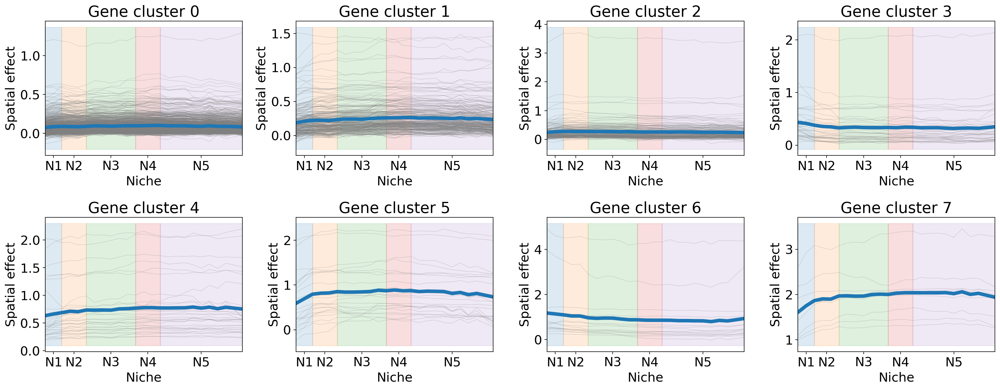

In [507]:
df = pd.DataFrame(adata_mtg_c1.X,columns = adata_mtg_se_1.var_names)
df['x'] = adata_mtg_c1.obsm['spatial'][:,1]

bins = np.linspace(df['x'].min(), df['x'].max(), 26)


df['bin'] = pd.cut(df['x'], bins=bins, include_lowest=True, labels=range(25))


bin_means = df.groupby('bin').mean().dropna()
bin_means = bin_means.iloc[:,:-1]

fig, axes = plt.subplots(2,4,figsize=(20,8))
c_list = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd']
j = 0
k = 0
for i in range(8):
    ind = pd.DataFrame(kmeans.labels_).value_counts().index.values[i][0]
    axes[j,k].plot(bin_means.index.astype(int),bin_means.loc[:,kmeans.labels_==ind].values,color='gray',linewidth=0.5,alpha=0.35)
    axes[j,k].plot(bin_means.index.astype(int),np.mean(bin_means.loc[:,kmeans.labels_==ind].values,axis=1),linewidth=5)
    axes[j,k].set_xlabel('Niche')
    
    custom_ticks = [1, 3.5,8,12.5,19]
    custom_labels = ['N1','N2','N3','N4','N5']
    axes[j,k].set_xticks(custom_ticks, custom_labels)
    axes[j,k].set_ylabel('Spatial effect')
    axes[j,k].set_xlim((0,24))
    axes[j,k].set_title('Gene cluster '+str(i))
    x = bin_means.index.astype(int)
    y = axes[j,k].get_ylim()
    axes[j,k].fill_between(bin_means.index.astype(int), y[1],y[0], where=(x <= 2), color=c_list[0], alpha=0.15)
    axes[j,k].fill_between(bin_means.index.astype(int), y[1],y[0], where=(x >= 2) & (x <= 5), color=c_list[1], alpha=0.15)
    axes[j,k].fill_between(bin_means.index.astype(int), y[1],y[0], where=(x >= 5) & (x <= 11), color=c_list[2], alpha=0.15)
    axes[j,k].fill_between(bin_means.index.astype(int), y[1],y[0], where=(x >= 11) & (x <= 14), color=c_list[3], alpha=0.15)
    axes[j,k].fill_between(bin_means.index.astype(int), y[1],y[0], where=(x >= 14) & (x <= 24), color=c_list[4], alpha=0.15)
    k = k + 1
    if k > 3:
        k = 0
        j = 1
        
        
plt.tight_layout()
plt.savefig('figures/mtg_ASC_cside.pdf',bbox_inches='tight')

In [510]:
from scipy.stats import kendalltau
from scipy.stats import spearmanr
from sklearn.neighbors import kneighbors_graph

from sklearn.linear_model import LinearRegression

adata_mtg_.obsm['S'] = S.copy()

lr = LinearRegression()
adata_mtg_.obsm['ct_s'] = np.hstack((pd.get_dummies(adata_mtg_.obs['cluster_L2']).values,adata_mtg_.obsm['S']))
lr.fit(adata_mtg_.obsm['ct_s'], adata_mtg_.X)

adata_mtg_c1 = adata_mtg_[adata_mtg_.obs['batch']==adata_mtg_se.obs['batch'].unique()[0]].copy()
adata_mtg_c1 = adata_mtg_c1[adata_mtg_c1.obs['cluster_L1']=='lASC']

adata_mtg_c1.X = lr.predict(adata_mtg_c1.obsm['ct_s'])



sp_c2 = np.zeros(adata_mtg_c1.shape[1])
kt_c2 = np.zeros(adata_mtg_c1.shape[1])
j = 0
for source_row in adata_mtg_c1.X.T:
    sp_c2[j], pv = spearmanr(source_row, adata_mtg_1.obsm['spatial'][:,1])
    kt_c2[j], pv = kendalltau(source_row, adata_mtg_1.obsm['spatial'][:,1])
    j = j + 1
kt_c2 = np.abs(kt_c2)
sp_c2 = np.abs(sp_c2)

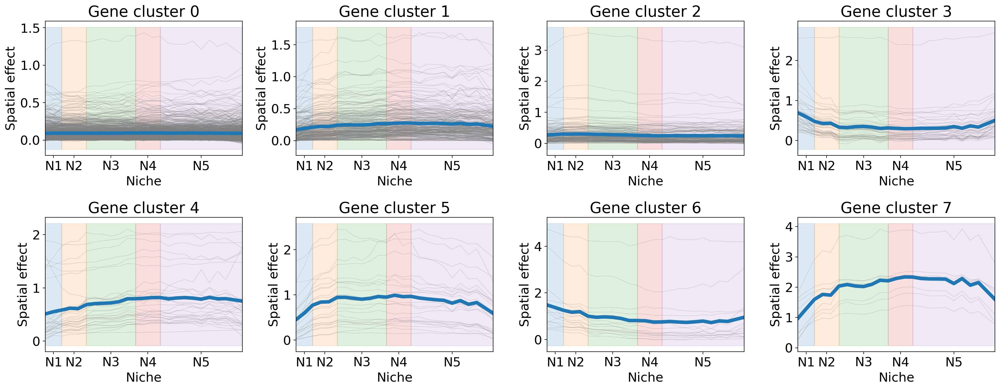

In [496]:
df = pd.DataFrame(adata_mtg_c1.X,columns = adata_mtg_se_1.var_names)
df['x'] = adata_mtg_c1.obsm['spatial'][:,1]

bins = np.linspace(df['x'].min(), df['x'].max(), 26)


df['bin'] = pd.cut(df['x'], bins=bins, include_lowest=True, labels=range(25))


bin_means = df.groupby('bin').mean().dropna()
bin_means = bin_means.iloc[:,:-1]

fig, axes = plt.subplots(2,4,figsize=(20,8))
c_list = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd']
j = 0
k = 0
for i in range(8):
    ind = pd.DataFrame(kmeans.labels_).value_counts().index.values[i][0]
    axes[j,k].plot(bin_means.index.astype(int),bin_means.loc[:,kmeans.labels_==ind].values,color='gray',linewidth=0.5,alpha=0.35)
    axes[j,k].plot(bin_means.index.astype(int),np.mean(bin_means.loc[:,kmeans.labels_==ind].values,axis=1),linewidth=5)
    axes[j,k].set_xlabel('Niche')
    
    custom_ticks = [1, 3.5,8,12.5,19]
    custom_labels = ['N1','N2','N3','N4','N5']
    axes[j,k].set_xticks(custom_ticks, custom_labels)
    axes[j,k].set_ylabel('Spatial effect')
    axes[j,k].set_xlim((0,24))
    axes[j,k].set_title('Gene cluster '+str(i))
    x = bin_means.index.astype(int)
    y = axes[j,k].get_ylim()
    axes[j,k].fill_between(bin_means.index.astype(int), y[1],y[0], where=(x <= 2), color=c_list[0], alpha=0.15)
    axes[j,k].fill_between(bin_means.index.astype(int), y[1],y[0], where=(x >= 2) & (x <= 5), color=c_list[1], alpha=0.15)
    axes[j,k].fill_between(bin_means.index.astype(int), y[1],y[0], where=(x >= 5) & (x <= 11), color=c_list[2], alpha=0.15)
    axes[j,k].fill_between(bin_means.index.astype(int), y[1],y[0], where=(x >= 11) & (x <= 14), color=c_list[3], alpha=0.15)
    axes[j,k].fill_between(bin_means.index.astype(int), y[1],y[0], where=(x >= 14) & (x <= 24), color=c_list[4], alpha=0.15)
    k = k + 1
    if k > 3:
        k = 0
        j = 1
        
        
plt.tight_layout()
plt.savefig('figures/mtg_ASC_cside_arch.pdf',bbox_inches='tight')

In [558]:
from scipy.stats import kendalltau
from scipy.stats import spearmanr
from sklearn.neighbors import kneighbors_graph

from sklearn.linear_model import LinearRegression

adata_mtg_.obsm['S'] = S.copy()

lr = LinearRegression()
adata_mtg_.obsm['ct_s'] = np.hstack((pd.get_dummies(adata_mtg_.obs['cluster_L2']).values,adata_mtg_.obsm['S']))

adata_mtg_c1 = adata_mtg_[adata_mtg_.obs['batch']==adata_mtg_se.obs['batch'].unique()[0]].copy()
adata_mtg_c1 = adata_mtg_c1[adata_mtg_c1.obs['cluster_L1']=='lASC']
lr.fit(adata_mtg_c1.obsm['ct_s'], adata_mtg_c1.X)

adata_mtg_c1.X = lr.predict(adata_mtg_c1.obsm['ct_s'])




sp_c3 = np.zeros(adata_mtg_c1.shape[1])
kt_c3 = np.zeros(adata_mtg_c1.shape[1])
j = 0
for source_row in adata_mtg_c1.X.T:
    sp_c3[j], pv = spearmanr(source_row, adata_mtg_1.obsm['spatial'][:,1])
    kt_c3[j], pv = kendalltau(source_row, adata_mtg_1.obsm['spatial'][:,1])
    j = j + 1
kt_c3 = np.abs(kt_c3)
sp_c3 = np.abs(sp_c3)

/usr/local/lib/python3.8/dist-packages/scipy/stats/_stats_py.py:4916: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(warn_msg))


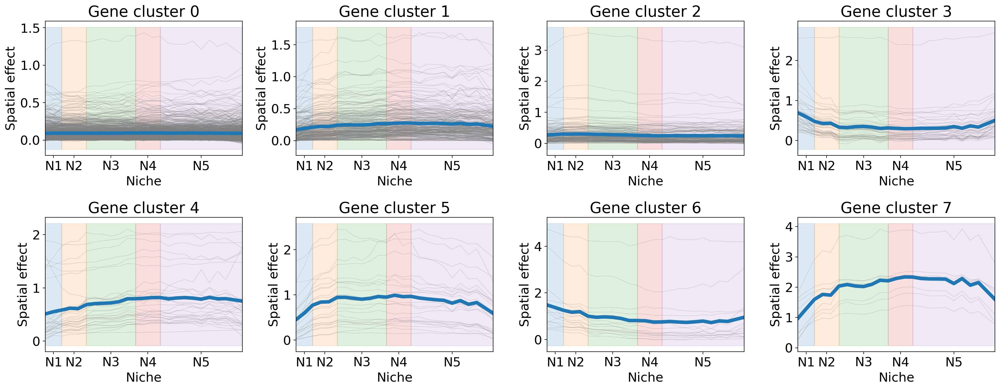

In [566]:
df = pd.DataFrame(adata_mtg_c1.X,columns = adata_mtg_se_1.var_names)
df['x'] = adata_mtg_c1.obsm['spatial'][:,1]

bins = np.linspace(df['x'].min(), df['x'].max(), 26)


df['bin'] = pd.cut(df['x'], bins=bins, include_lowest=True, labels=range(25))


bin_means = df.groupby('bin').mean().dropna()
bin_means = bin_means.iloc[:,:-1]

fig, axes = plt.subplots(2,4,figsize=(20,8))
c_list = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd']
j = 0
k = 0
for i in range(8):
    ind = pd.DataFrame(kmeans.labels_).value_counts().index.values[i][0]
    axes[j,k].plot(bin_means.index.astype(int),bin_means.loc[:,kmeans.labels_==ind].values,color='gray',linewidth=0.5,alpha=0.35)
    axes[j,k].plot(bin_means.index.astype(int),np.mean(bin_means.loc[:,kmeans.labels_==ind].values,axis=1),linewidth=5)
    axes[j,k].set_xlabel('Niche')
    
    custom_ticks = [1, 3.5,8,12.5,19]
    custom_labels = ['N1','N2','N3','N4','N5']
    axes[j,k].set_xticks(custom_ticks, custom_labels)
    axes[j,k].set_ylabel('Spatial effect')
    axes[j,k].set_xlim((0,24))
    axes[j,k].set_title('Gene cluster '+str(i))
    x = bin_means.index.astype(int)
    y = axes[j,k].get_ylim()
    axes[j,k].fill_between(bin_means.index.astype(int), y[1],y[0], where=(x <= 2), color=c_list[0], alpha=0.15)
    axes[j,k].fill_between(bin_means.index.astype(int), y[1],y[0], where=(x >= 2) & (x <= 5), color=c_list[1], alpha=0.15)
    axes[j,k].fill_between(bin_means.index.astype(int), y[1],y[0], where=(x >= 5) & (x <= 11), color=c_list[2], alpha=0.15)
    axes[j,k].fill_between(bin_means.index.astype(int), y[1],y[0], where=(x >= 11) & (x <= 14), color=c_list[3], alpha=0.15)
    axes[j,k].fill_between(bin_means.index.astype(int), y[1],y[0], where=(x >= 14) & (x <= 24), color=c_list[4], alpha=0.15)
    k = k + 1
    if k > 3:
        k = 0
        j = 1
        
        
plt.tight_layout()
plt.savefig('figures/mtg_ASC_cside_ct.pdf',bbox_inches='tight')

In [596]:
from scipy.stats import kendalltau
from scipy.stats import spearmanr
from sklearn.neighbors import kneighbors_graph

from sklearn.linear_model import LinearRegression

adata_mtg_.obsm['S'] = S.copy()

lr = LinearRegression()
adata_mtg_.obsm['ct_s'] = np.hstack((pd.get_dummies(adata_mtg_.obs['cluster_L2']).values,adata_mtg_.obsm['simvi_s']))

adata_mtg_c1 = adata_mtg_[adata_mtg_.obs['batch']==adata_mtg_se.obs['batch'].unique()[0]].copy()
adata_mtg_c1 = adata_mtg_c1[adata_mtg_c1.obs['cluster_L1']=='lASC']
lr.fit(adata_mtg_c1.obsm['ct_s'], adata_mtg_c1.X)

adata_mtg_c1.X = lr.predict(adata_mtg_c1.obsm['ct_s'])


sp_c4 = np.zeros(adata_mtg_c1.shape[1])
kt_c4 = np.zeros(adata_mtg_c1.shape[1])
j = 0
for source_row in adata_mtg_c1.X.T:
    sp_c4[j], pv = spearmanr(source_row, adata_mtg_1.obsm['spatial'][:,1])
    kt_c4[j], pv = kendalltau(source_row, adata_mtg_1.obsm['spatial'][:,1])
    j = j + 1
kt_c4 = np.abs(kt_c4)
sp_c4 = np.abs(sp_c4)




/usr/local/lib/python3.8/dist-packages/scipy/stats/_stats_py.py:4916: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(warn_msg))


In [403]:
## running above cells with adata_mtg_1.obsm['spatial'][:,0]

sp_df2 = pd.DataFrame(np.vstack((sp,sp_scvi,sp_go,sp_k,sp_se)).T,index=adata_mtg_1.var_names,columns=['Preprocessed','scVI decoder','NCEM','k-NN','SIMVI DML'])
kt_df2 = pd.DataFrame(np.vstack((kt,kt_scvi,sp_go,kt_k,kt_se)).T,index=adata_mtg_1.var_names,columns=['Preprocessed','scVI decoder','NCEM','k-NN','SIMVI DML'])

sp_df2['kmeans'] = kmeans.labels_.copy()
kt_df2['kmeans'] = kmeans.labels_.copy()

tmp = kt_df2['kmeans'].value_counts().rank(ascending=False).astype(int)

sp_df2['kmeans'] = sp_df2['kmeans'].map(tmp) - 1
kt_df2['kmeans'] = kt_df2['kmeans'].map(tmp) - 1

sp_df2['NCEM'] = sp_go
kt_df2['NCEM'] = kt_go

sp_df2['cside (arch)'] = sp_c2
kt_df2['cside (arch)'] = kt_c2

sp_df2['cside_ct'] = sp_c3
kt_df2['cside_ct'] = kt_c3

sp_df2['cside_ct_oris'] = sp_c4
kt_df2['cside_ct_oris'] = kt_c4

In [406]:
## running above cells with adata_mtg_1.obsm['spatial'][:,1]

sp_df = pd.DataFrame(np.vstack((sp,sp_scvi,sp_k,sp_se)).T,index=adata_mtg_1.var_names,columns=['Preprocessed','scVI decoder','k-NN','SIMVI DML'])
kt_df = pd.DataFrame(np.vstack((kt,kt_scvi,kt_k,kt_se)).T,index=adata_mtg_1.var_names,columns=['Preprocessed','scVI decoder','k-NN','SIMVI DML'])

sp_df['kmeans'] = kmeans.labels_.copy()
kt_df['kmeans'] = kmeans.labels_.copy()

tmp = kt_df['kmeans'].value_counts().rank(ascending=False).astype(int)

sp_df['kmeans'] = sp_df['kmeans'].map(tmp) - 1
kt_df['kmeans'] = kt_df['kmeans'].map(tmp) - 1

sp_df['NCEM'] = sp_go
kt_df['NCEM'] = kt_go

sp_df['cside (arch)'] = sp_c2
kt_df['cside (arch)'] = kt_c2

sp_df['cside_ct'] = sp_c3
kt_df['cside_ct'] = kt_c3

sp_df['cside_ct_oris'] = sp_c4
kt_df['cside_ct_oris'] = kt_c4

In [601]:
sp_df.to_csv('Benchmarking_results/mtg_se_asc_sp.csv')
kt_df.to_csv('Benchmarking_results/mtg_se_asc_kt.csv')

In [602]:
sp_df2.to_csv('Benchmarking_results/mtg_se_asc_sp_x.csv')
kt_df2.to_csv('Benchmarking_results/mtg_se_asc_kt_x.csv')

In [424]:
np.save('Bio_results/MTG/r2_z.npy',np.vstack(r2_zlist))
np.save('Bio_results/MTG/r2_s.npy',np.vstack(r2_slist))
np.save('Bio_results/MTG/r2_zpv.npy',np.vstack(r2_zpvlist))
np.save('Bio_results/MTG/r2_spv.npy',np.vstack(r2_spvlist))
np.save('Bio_results/MTG/S.npy',S)
adata_mtg_se.write('Bio_results/MTG/mtg_se.h5ad')

In [6]:
# All archetypes in one regression model -- mode = 'all'

adata_mtg.obsm['simvi_s'] = adata_mtg_se.obsm['simvi_s'].copy()
adata_mtg.obsm['simvi_z'] = adata_mtg_se.obsm['simvi_z'].copy()
se, r2_z, r2_s, r2_zpv, r2_spv, S = model.get_se(edge_index,adata=adata_mtg,num_arch =7, Kfold=1,cell_type_label='cluster_L2',mode='all')

adata_mtg.var['r2_z'] = r2_z
adata_mtg.var['r2_s'] = r2_s

In [14]:
adata_mtg_se = adata_mtg.copy()
adata_mtg_se.X = se
adata_mtg_se.X

array([[ 0.01692143, -0.01174113, -0.00751983, ...,  0.01475266,
        -0.01563141,  0.        ],
       [ 0.04740843, -0.02230352, -0.00291476, ..., -0.00189323,
         0.00378755,  0.        ],
       [ 0.11527753,  0.05225787, -0.00458283, ..., -0.05970845,
        -0.01268077,  0.        ],
       ...,
       [-0.1057865 ,  0.03048836, -0.00326762, ...,  0.00076018,
        -0.02384818,  0.        ],
       [-0.04161774, -0.00332005, -0.0276771 , ...,  0.06203226,
        -0.02357574,  0.        ],
       [ 0.02534868, -0.00493332, -0.00862285, ...,  0.06144519,
         0.01970007,  0.        ]])

/usr/local/lib/python3.8/dist-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/usr/lib/python3.8/contextlib.py:120: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  next(self.gen)
/usr/local/lib/python3.8/dist-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/usr/local/lib/python3.8/dist-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/usr/local/lib/python3.8/dist-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view,

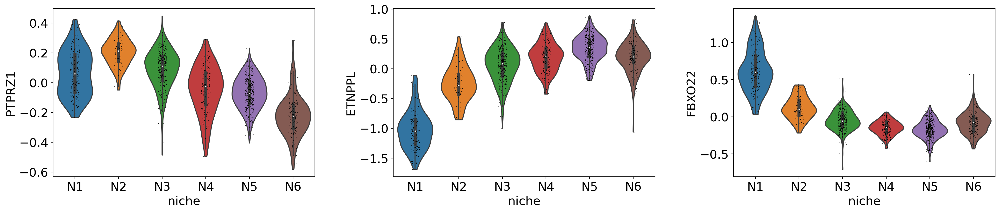

In [15]:
sc.pl.violin(adata_mtg_se[adata_mtg.obs['cluster_L1']=='lASC'],['PTPRZ1','ETNPPL','FBXO22'],'niche',inner='box')

In [30]:
tmpX = sc.read_h5ad('Bio_results/MTG/mtg_se.h5ad').X
tmp = np.zeros(tmpX.shape[1])
from scipy.stats import spearmanr
for i in range(tmpX.shape[1]):
    tmp[i], pv = pearsonr(adata_mtg_se.X[:,i],tmpX[:,i])
    
tmp2 = np.zeros(tmpX.shape[1])
for i in range(tmpX.shape[1]):
    tmp2[i], pv = spearmanr(adata_mtg_se.X[:,i],tmpX[:,i])

/usr/local/lib/python3.8/dist-packages/scipy/stats/_stats_py.py:4916: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(warn_msg))


/tmp/ipykernel_668296/276050792.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata_mtg_.var['class'][adata_mtg_.var['r2_z']>0.6] = 'Cell-type specific'
/tmp/ipykernel_668296/276050792.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata_mtg_.var['class'][np.abs(adata_mtg_.var['r2_s'].values - hr.predict(adata_mtg_.var['r2_z'].values.reshape(-1,1)) ) / hr.scale_ > 10] = 'Spatial-induced'


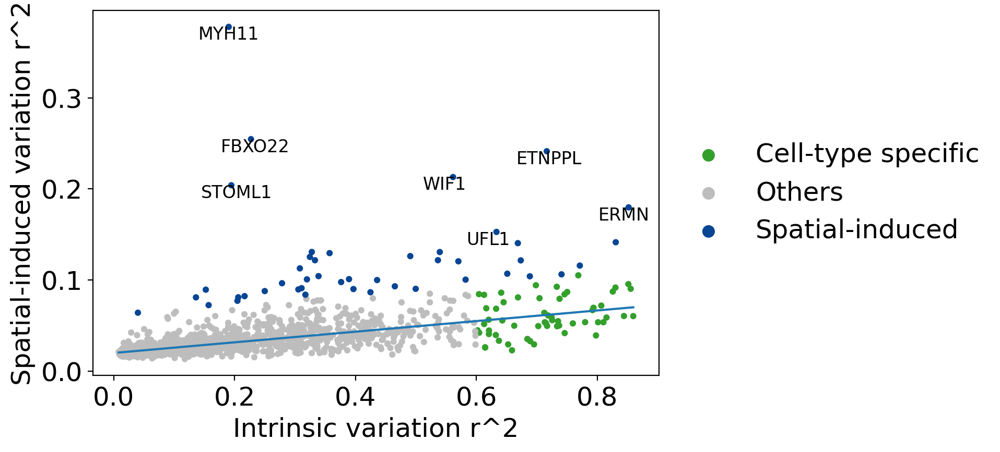

In [41]:
from sklearn.linear_model import HuberRegressor

hr = HuberRegressor()
hr.fit(adata_mtg_.var['r2_z'].values.reshape(-1,1),adata_mtg_.var['r2_s'].values)


adata_mtg_.var['class'] = 'Others'

adata_mtg_.var['class'][adata_mtg_.var['r2_z']>0.6] = 'Cell-type specific'
adata_mtg_.var['class'][np.abs(adata_mtg_.var['r2_s'].values - hr.predict(adata_mtg_.var['r2_z'].values.reshape(-1,1)) ) / hr.scale_ > 10] = 'Spatial-induced'

import matplotlib.pyplot as plt
plt.rcParams['figure.dpi'] = 200
plt.rcParams["font.size"] = 18

adata_mtg_.uns['class_colors'] = ['#33a02c','#bdbdbd','#084594']



sc.pl.scatter(adata_mtg_.copy(),x='r2_z',y='r2_s',show=False,color='class')
plt.plot(adata_mtg_.var['r2_z'].values[np.argsort(adata_mtg_.var['r2_z'].values)],hr.predict(adata_mtg_.var['r2_z'].values.reshape(-1,1))[np.argsort(adata_mtg_.var['r2_z'].values)])

for i in range(adata_mtg_.var['r2_s'].shape[0]):
    if adata_mtg_.var['r2_s'][i] > 0.15:
        plt.text(adata_mtg_.var['r2_z'][i]-0.05,adata_mtg_.var['r2_s'][i]-0.014,adata_mtg_.var_names[i],fontsize=12)
        
plt.xlabel('Intrinsic variation r^2')
plt.ylabel('Spatial-induced variation r^2')
plt.title('')
plt.savefig('figures/r2scatter_mtg_v2all.pdf')


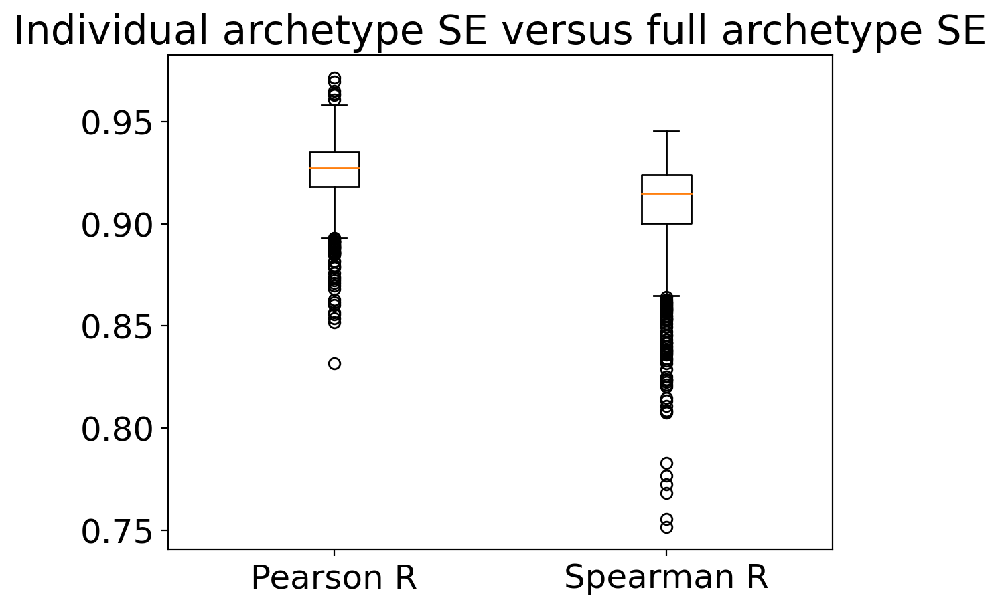

In [42]:
plt.boxplot(np.vstack((tmp[adata_mtg.var_names.isin(adata_mtg_.var_names)],tmp2[adata_mtg.var_names.isin(adata_mtg_.var_names)])).T,labels=['Pearson R','Spearman R'])
plt.title('Individual archetype SE versus full archetype SE')
#plt.xticklabels(['Pearsonr','Spearmanr'])
plt.savefig('figures/comparison_se_boxplot.pdf')